In [330]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

import warnings as kxe_kxe
kxe_kxe.filterwarnings('ignore')

# 1. Загрузка и предобработка данных из Electricity_consumption.csv

## Возьмем данные из файла

In [331]:
data = pd.read_csv('data/Electricity_consumption.csv', sep=";") # parse_dates=['timestamp'])  #, date_format={'timestamp': '%Y-%m-%d %H:%M:%S'}) # будем по старинке

data.head()

,Unnamed: 0,timestamp,demand_kW,apparent_temperature,air_temperature,dew_point_temperature,relative_humidity,wind_speed
0,1,2018-01-01,"375,996857142857","16,6","16,2","13,5",84,"3,6"
1,2,2018-01-01 01:00:00,"373,581714285714","16,7","15,6","13,4",87,0
2,3,2018-01-01 02:00:00,"372,714428571429","16,2","15,1","13,6",91,0
3,4,2018-01-01 03:00:00,"374,887428571429","15,9","14,8","14,6",99,"1,8"
4,5,2018-01-01 04:00:00,"370,359857142857","16,2","14,8","14,5",98,0


Проверим на пропуски

In [332]:
data.isna().sum()

Unnamed: 0               0
timestamp                0
demand_kW                0
apparent_temperature     0
air_temperature          0
dew_point_temperature    0
relative_humidity        0
wind_speed               0
dtype: int64

пропусков нету

Видно, что столбец `Unnamed: 0` нам не нужен<br>
Все остальные столбцы, кроме `timestamp` представлены числовыми значения 

In [333]:
data.drop('Unnamed: 0', axis=1, inplace=True)

for i in data.columns[1:]:
    data[i] = data[i].transform(lambda x: np.float64(x.replace(',','.')))
    
data['timestamp'] = pd.to_datetime(data['timestamp'], format = 'mixed')

data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30627 entries, 0 to 30626
Data columns (total 7 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   timestamp              30627 non-null  datetime64[ns]
 1   demand_kW              30627 non-null  float64       
 2   apparent_temperature   30627 non-null  float64       
 3   air_temperature        30627 non-null  float64       
 4   dew_point_temperature  30627 non-null  float64       
 5   relative_humidity      30627 non-null  float64       
 6   wind_speed             30627 non-null  float64       
dtypes: datetime64[ns](1), float64(6)
memory usage: 1.6 MB


Теперь все правильно

# 2. Выполнить быстрое преобразование Фурье для удаления сезонных компонентов (суточных, недельных и годовых циклов) в отношении экзогенной переменной– demand_kW по подобранному threshold на базе анализа частотной спектрограммы.

## Реализуем БЫСТРОЕ преобразование Фурье и обратное

In [334]:
# Рекурсивная реализация БПФ с переименованными переменными
def fft_not_padded(signal):
    signal = np.asarray(signal)
    size = signal.shape[0]
    
    if size <= 1:
        return signal
        
    # Разделение на четные/нечетные индексы
    even_part = fft(signal[::2])
    odd_part = fft(signal[1::2])
    
    # Вычисление поворотных коэффициентов
    exponents = np.arange(size // 2)
    twiddle_factors = np.exp(-2j * np.pi * exponents / size) * odd_part
    
    # Комбинирование результатов
    first_half = even_part + twiddle_factors
    second_half = even_part - twiddle_factors
    
    return np.concatenate([first_half, second_half])

# БПФ с дополнением до степени двойки 
def fft(data):
    """Вычисление БПФ с дополнением до ближайшей степени двойки"""
    length = len(data)
    
    # Вычисление ближайшей степени двойки через битовый сдвиг
    power = 0
    while (1 << power) < length:
        power += 1
    padded_length = 1 << power
    
    # Дополнение нулями
    padded_data = np.pad(data, (0, padded_length - length), 'constant')
    
    return fft_not_padded(padded_data)

def ifft(x):
    x = np.asarray(x, dtype=complex)
    N = x.shape[0]
    if N <= 1:
        return x
    
    # Проверка и дополнение до степени двойки
    if np.log2(N) % 1 != 0:
        next_pow2 = 1 << (N - 1).bit_length()
        x = np.concatenate([x, np.zeros(next_pow2 - N)])
    
    x_conj = np.conjugate(x)
    result_conj = fft(x_conj)
    result = np.conjugate(result_conj) / N
    return result

def fftfreq(n, d=1.0):
    """
    Вычисляет частоты бинов для ДПФ (дискретного преобразования Фурье).
    
    Параметры:
    - n: int, длина окна (количество точек в массиве).
    - d: float, шаг выборки (обратная величина частоты дискретизации, по умолчанию 1).
    
    Возвращает:
    - Массив частот, соответствующих результатам ДПФ.
    """
    val = 1.0 / (n * d)
    freqs = np.arange(n)
    # Для индексов > n//2 вычитаем n, чтобы получить отрицательные частоты
    freqs = np.where(freqs > n // 2, freqs - n, freqs)
    return freqs * val

## Посмотрим на сами данные 

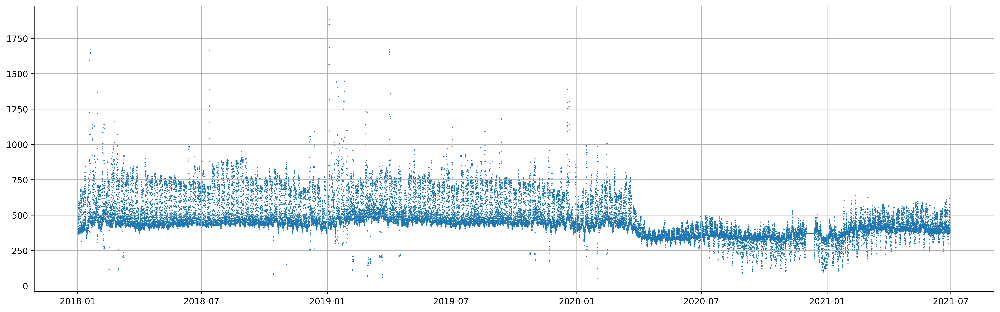

In [335]:
plt.figure(figsize=(20, 6), dpi=500)
plt.scatter(data.timestamp,data.demand_kW.values, label = 'origin',s =0.2)
plt.grid()
plt.show()

Видно, что есть какие-то циклические изменения. Посмотрим на них поближе

In [336]:
def find_peaks(y, threshold=0, min_distance=1):
    """
    Поиск локальных максимумов в массиве
    
    Parameters:
    y (array): Массив значений
    threshold (float): Минимальная амплитуда пика
    min_distance (int): Минимальное расстояние между пиками
    
    Returns:
    list: Индексы пиков
    """
    peaks = []
    last_peak_idx = -np.inf
    
    for i in range(1, len(y)-1):
        # Проверка локального максимума
        if y[i] > y[i-1] and y[i] > y[i+1]:
            # Порог амплитуды
            if y[i] > threshold:
                # Минимальное расстояние между пиками
                if i - last_peak_idx >= min_distance:
                    peaks.append(i)
                    last_peak_idx = i
    
    return peaks

In [337]:
def polyfit(x,y):
    # Подготовка данных
    x = np.array(x)
    y = np.array(y)

    # Расчёт сумм для формул
    n = len(x)
    sum_x = np.sum(x)
    sum_y = np.sum(y)
    sum_xy = np.sum(x * y)
    sum_x_sq = np.sum(x ** 2)

    # Вычисление коэффициентов
    a = (n * sum_xy - sum_x * sum_y) / (n * sum_x_sq - sum_x ** 2)
    b = (sum_y - a * sum_x) / n

    return [a, b]

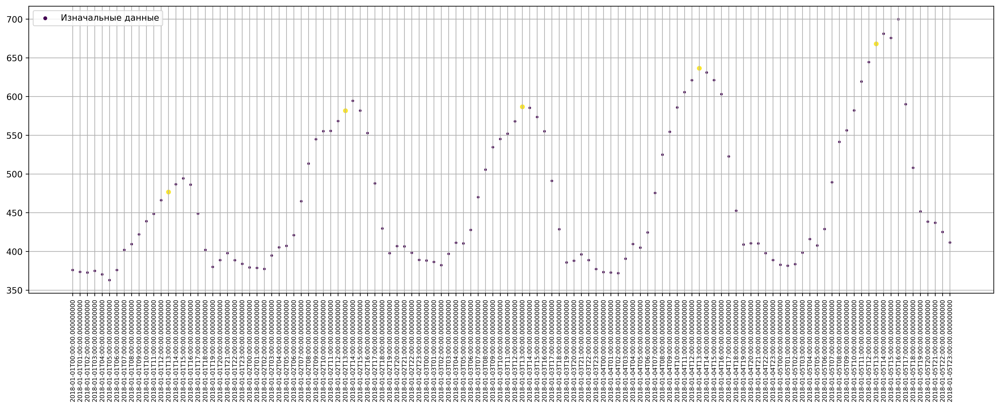

In [338]:
till_idx =24*5
y = data.demand_kW.values[:till_idx]
timestamp = data.timestamp[:till_idx]

peaks_idx = find_peaks(
    y,
    min_distance=9
)

mask = data.timestamp.dt.hour == 13 
filtered_series = timestamp[mask]


s = np.ones(till_idx)*4
s[filtered_series.index] = 20


plt.figure(figsize=(20, 6), dpi=500)
plt.scatter(timestamp.index,y, label = 'Изначальные данные', c = s,sizes = s)
plt.xticks(timestamp.index,labels=timestamp.values)
plt.xticks(rotation=90,size=7)
plt.legend()
plt.grid()
plt.show()

Примерно в 13 часов дня наблюдается ежедневный пик в потребляемой мощности

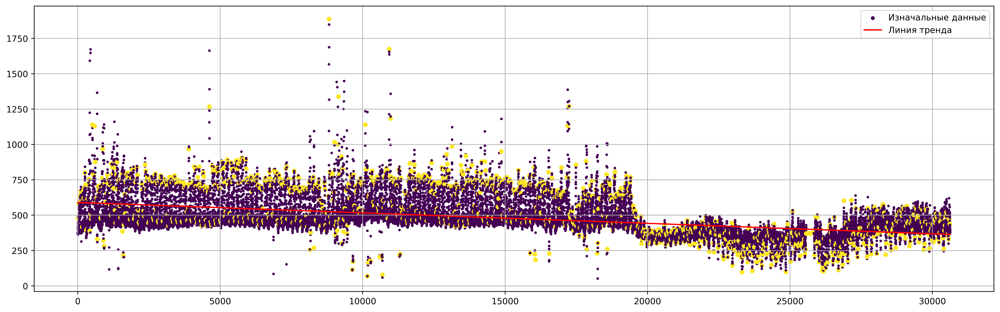

In [339]:
till_idx = data.demand_kW.values.size
y = data.demand_kW.values[:till_idx]
timestamp = data.timestamp[:till_idx]

peaks_idx = find_peaks(
    y,
    min_distance=9
)

mask = data.timestamp.dt.hour == 13 
filtered_series = timestamp[mask]


s = np.ones(till_idx)*4
s[filtered_series.index] = 20

# Подгонка линейного тренда
coefficients = polyfit(timestamp.index,y) #np.polyfit(timestamp.index,y, 1)
# Получение коэффициентов (угловой коэффициент и свободный член)
slope, intercept = coefficients
line = slope * timestamp.index + intercept



plt.figure(figsize=(20, 6), dpi=500)
plt.scatter(timestamp.index,y, label = 'Изначальные данные', c = s,sizes = s)#, s=s)#,s =0.2)
plt.plot(timestamp.index, line, color='red', label='Линия тренда')
#plt.xticks(timestamp.index,labels=timestamp.values)
#plt.xticks(rotation=90,size=7)
plt.legend()
plt.grid()
plt.show()

Вычтем тренд, операции с удалением сезонности не любят тренд

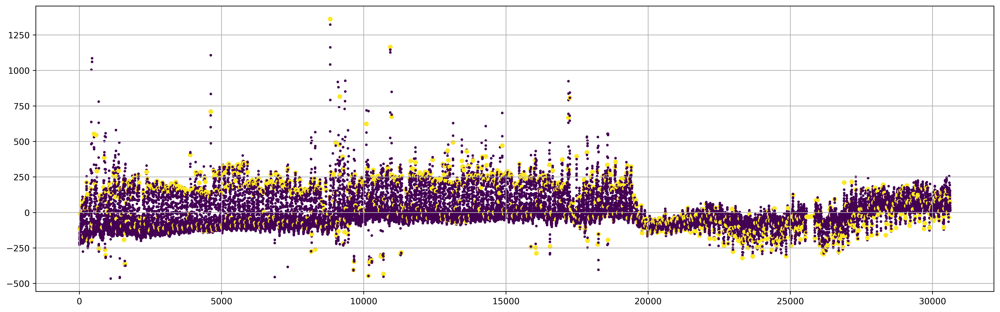

In [340]:
y_line = y-line

length = len(y_line)

# Вычисление ближайшей степени двойки через битовый сдвиг
power = 0
while (1 << power) < length:
    power += 1
padded_length = 1 << power

# Дополнение нулями
padded_y_line = np.pad(y_line, (0, padded_length - length), 'constant')

plt.figure(figsize=(20, 6), dpi=500)
plt.scatter(timestamp.index,y_line, label = 'origin', c = s,sizes = s)#, s=s)#,s =0.2)
plt.grid()
plt.show()


Ежедневная сезонность точно есть. Попробуем ее убрать

## Проведем FFT

In [341]:
fft_result = fft(padded_y_line) #np.fft.fft(y_line)
freq = fftfreq(len(padded_y_line)) # np.fft.fftfreq(len(y_line))

## Выберем частоты

In [342]:
seasonal_freqs = [] # список для запоминания частот

In [343]:
n = len(padded_y_line)
half_n = n // 2
posi_freq = freq[:half_n]
amplitudes = np.abs(fft_result[:half_n])

max_amp_indexes = (np.argsort(amplitudes[1:])[::-1] + 1 )[:1] # Пропустите нулевую частоту
seasonal_freq = freq[max_amp_indexes]

period_hours = (1 / seasonal_freq)
period_hours = period_hours[period_hours<10000]

print(period_hours)
seasonal_freqs.append(1/period_hours[0])

[24.00586081]


Первой же частотой стала ежедневная сезонность<br>
Смотрим дальше

In [344]:
max_amp_indexes = (np.argsort(amplitudes[1:])[::-1] + 1 )[:5] # Пропустите нулевую частоту
seasonal_freq = freq[max_amp_indexes]

period_hours = (1 / seasonal_freq)
period_hours = period_hours[period_hours<10000]
period_hours = period_hours[abs(period_hours - 24)>8]

print(period_hours)
seasonal_freqs.append(1/period_hours[0])

[168.04102564]


Далее находим еженедельную сезонность

В задании также говорилось про ежегодную сезонность. Найдем и ее

In [345]:
max_amp_indexes = (np.argsort(amplitudes[1:])[::-1] + 1 )[:500] # Пропустите нулевую частоту
seasonal_freq = freq[max_amp_indexes]

period_hours = (1 / seasonal_freq)
period_hours = period_hours[period_hours<10000]

period_hours = period_hours[period_hours>8000]

print(period_hours)

[8192.]


Это примерно ежегодная сезонность. Других частот, где больше `8000` часов найти невозможно. Так что добавим в наш список и ее

In [346]:
seasonal_freqs.append(1/period_hours[0])

## Обнулим амплитуду

In [347]:
tolerance = 0.2  # Толерантность для поиска близких частот

for seasonal_freq in seasonal_freqs:
    fft_result[np.abs(freq - seasonal_freq) < tolerance] = 0

# 3. Выполнить обратное преобразование.

## Вернем наши значения через обратное преобразование

In [348]:
detrended_y = ifft(fft_result).real[:timestamp.index.size]

## Визуализируем

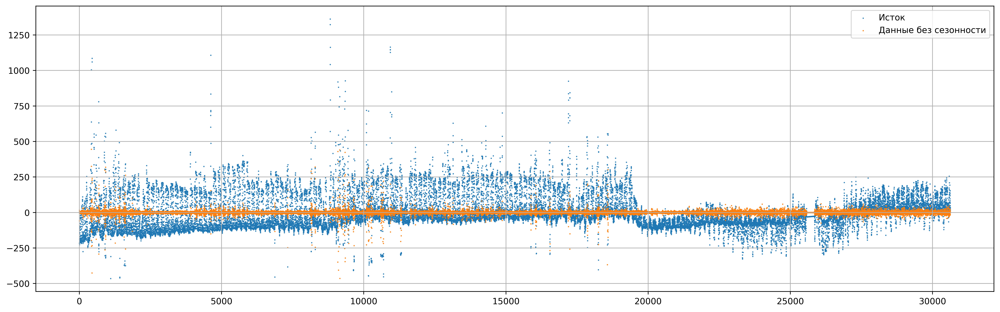

In [349]:
# Подгонка линейного тренда
coefficients = polyfit(timestamp.index,detrended_y) #np.polyfit(pd.RangeIndex(0,detrended_y.size),detrended_y,1)
# Получение коэффициентов (угловой коэффициент и свободный член)
slope, intercept = coefficients
line2 = slope * timestamp.index + intercept

plt.figure(figsize=(20, 6), dpi=500)
plt.scatter(timestamp.index,y_line, label = 'Исток', s = 0.2)

plt.scatter(timestamp.index,detrended_y, label = 'Данные без сезонности', s = 0.2, colorizer='b')#, s=s)#,s =0.2)
# plt.plot(timestamp.index, line2, color='red', label='Линия тренда 2')
# plt.plot(timestamp.index, line, color='g', label='Линия тренда 1')
#plt.vlines(30627,-500,500,'red',label='После этой линии просто дополнение до ближайшей степени 2')
plt.legend()
plt.grid()
plt.show()

Мы успешно убрали сезонность!

Добавим тренд

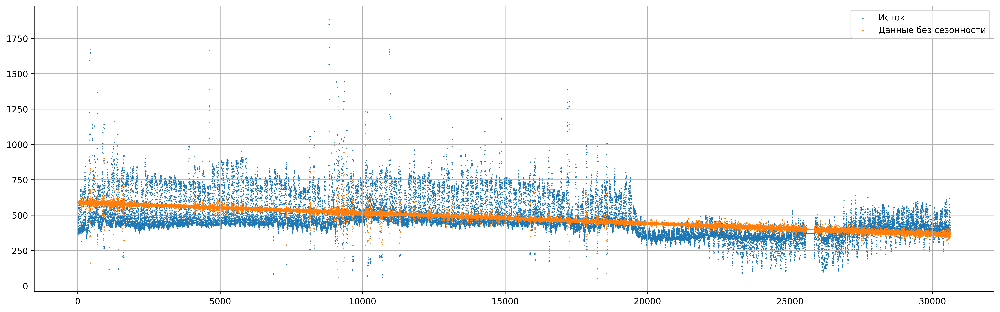

In [350]:
no_season_y = detrended_y+line

plt.figure(figsize=(20, 6), dpi=500)
plt.scatter(timestamp.index,y, label = 'Исток', s = 0.2)

plt.scatter(timestamp.index,no_season_y, label = 'Данные без сезонности', s = 0.2, colorizer='b')
plt.legend()
plt.grid()
plt.show()

# 4. Построить многомерную модель методами sklearn, описывающую полученные на предыдущем шаге данные с использованием признаков о погоде и т.п.

## Сначала нужно взять эндогенную переменную

In [351]:
df = data.copy()
X = df.drop(['timestamp','demand_kW'],axis=1)
X.head()

,apparent_temperature,air_temperature,dew_point_temperature,relative_humidity,wind_speed
0,16.6,16.2,13.5,84.0,3.6
1,16.7,15.6,13.4,87.0,0.0
2,16.2,15.1,13.6,91.0,0.0
3,15.9,14.8,14.6,99.0,1.8
4,16.2,14.8,14.5,98.0,0.0


In [352]:
no_season_y = pd.Series(no_season_y)

## 1st approach

In [353]:
from sklearn.model_selection import  GridSearchCV
from sklearn.ensemble import RandomForestRegressor
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error

Fitting 5 folds for each of 72 candidates, totalling 360 fits
Лучшие параметры: {'regressor__max_depth': 10, 'regressor__max_features': 'sqrt', 'regressor__min_samples_leaf': 2, 'regressor__min_samples_split': 5, 'regressor__n_estimators': 100}


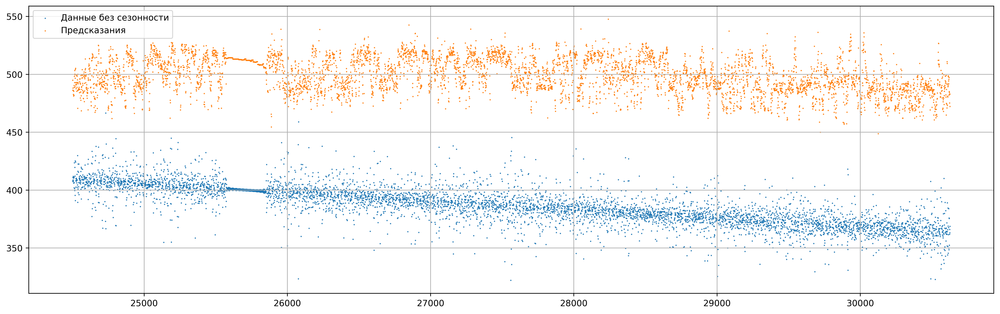

RMSE на тесте: 114.3620
MAE на тесте: 112.7233


In [354]:
# 1. Разделим выброрку на Train и Test
split_idx = int(X.shape[0] * 0.8)
X_train, X_test = X.iloc[:split_idx], X.iloc[split_idx:]
y_train, y_test = no_season_y.iloc[:split_idx], no_season_y.iloc[split_idx:]

# 2. Создаем пайплайн
pipeline = Pipeline([
    ('scaler', StandardScaler()),            # Нормализация признаков
    ('regressor', RandomForestRegressor(random_state=42))  # Регрессор
])

# 3. Параметры для перебора
parameters = {
    'regressor__n_estimators': [50, 100, 200],
    'regressor__max_depth': [None, 10, 20],
    'regressor__min_samples_split': [2, 5],
    'regressor__min_samples_leaf': [1, 2],
    'regressor__max_features': ['sqrt', 'log2']
}

# 4. GridSearchCV
grid_search = GridSearchCV(pipeline, parameters, cv=5, scoring='neg_mean_squared_error', n_jobs=-1, verbose=1)
grid_search.fit(X_train, y_train)

# 5. Лучшие параметры и оценка
print("Лучшие параметры:", grid_search.best_params_)

# 6. Оценка на тестовой выборке
y_pred = grid_search.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
mae = mean_absolute_error(y_test, y_pred)

plt.figure(figsize=(20, 6), dpi=500)
# plt.scatter(timestamp.index,y, label = 'Исток', s = 0.2)

plt.scatter(y_test.index,y_test, label = 'Данные без сезонности', s = 0.2, colorizer='b')
plt.scatter(y_test.index,y_pred, label = 'Предсказания', s = 0.2, colorizer='g')
plt.grid()
plt.legend()
plt.show()

print(f"RMSE на тесте: {rmse:.4f}")
print(f"MAE на тесте: {mae:.4f}")

Модель получилась не очень хорошей, так как она не учитывает тот факт, что это временной ряд. Другими словами нужно сделать лаговые сдвиги

## 2nd approach

Сделаем несколько лагов

In [355]:
df = data.copy()
df.drop(['timestamp','demand_kW'],axis=1, inplace=True)
df['target'] = no_season_y


lags = [1, 2, 3, 24]

for col in df.columns:
    for lag in lags:
        df[f'{col}_shift_{lag}'] = df[col].shift(lag)
        
df

,apparent_temperature,air_temperature,dew_point_temperature,relative_humidity,wind_speed,target,apparent_temperature_shift_1,apparent_temperature_shift_2,apparent_temperature_shift_3,apparent_temperature_shift_24,...,relative_humidity_shift_3,relative_humidity_shift_24,wind_speed_shift_1,wind_speed_shift_2,wind_speed_shift_3,wind_speed_shift_24,target_shift_1,target_shift_2,target_shift_3,target_shift_24
0,16.6,16.2,13.5,84.0,3.6,531.725931,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,16.7,15.6,13.4,87.0,0.0,594.910422,16.6,NaN,NaN,NaN,...,NaN,NaN,3.6,NaN,NaN,NaN,531.725931,NaN,NaN,NaN
2,16.2,15.1,13.6,91.0,0.0,606.156393,16.7,16.6,NaN,NaN,...,NaN,NaN,0.0,3.6,NaN,NaN,594.910422,531.725931,NaN,NaN
3,15.9,14.8,14.6,99.0,1.8,593.809589,16.2,16.7,16.6,NaN,...,84.0,NaN,0.0,0.0,3.6,NaN,606.156393,594.910422,531.725931,NaN
4,16.2,14.8,14.5,98.0,0.0,583.930242,15.9,16.2,16.7,NaN,...,87.0,NaN,1.8,0.0,0.0,NaN,593.809589,606.156393,594.910422,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30622,7.2,8.8,8.7,99.0,5.4,352.394548,8.3,9.5,9.4,4.1,...,87.0,100.0,3.6,0.0,9.4,0.0,375.464578,375.891478,348.521840,356.080224
30623,6.1,7.9,7.9,100.0,7.6,361.854594,7.2,8.3,9.5,3.8,...,90.0,100.0,5.4,3.6,0.0,0.0,352.394548,375.464578,375.891478,364.463582
30624,5.2,7.5,7.4,99.0,11.2,366.017954,6.1,7.2,8.3,3.2,...,98.0,100.0,7.6,5.4,3.6,0.0,361.854594,352.394548,375.464578,367.238493
30625,4.2,6.7,6.6,99.0,9.4,363.186455,5.2,6.1,7.2,1.9,...,99.0,100.0,11.2,7.6,5.4,0.0,366.017954,361.854594,352.394548,361.810168


Fitting 5 folds for each of 72 candidates, totalling 360 fits
Лучшие параметры: {'regressor__max_depth': None, 'regressor__max_features': 'sqrt', 'regressor__min_samples_leaf': 2, 'regressor__min_samples_split': 5, 'regressor__n_estimators': 50}


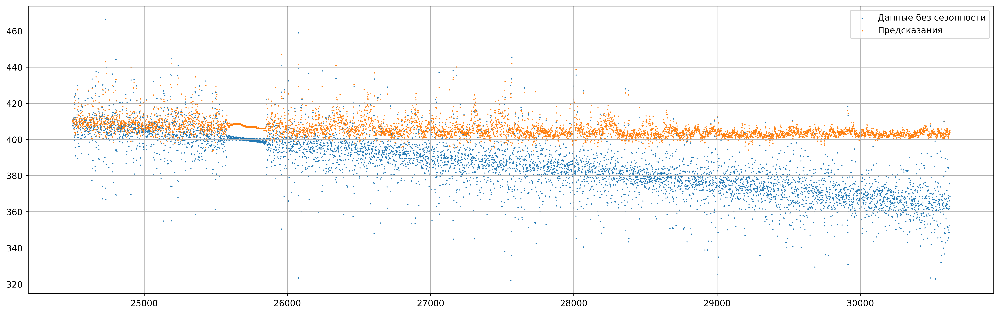

RMSE на тесте: 23.8894
MAE на тесте: 19.7041


In [356]:
# 1. Разделим выброрку на Train и Test
split_idx = int(df.shape[0] * 0.8)
X_train, X_test = df.iloc[:split_idx], df.iloc[split_idx:]
y_train, y_test = no_season_y.iloc[:split_idx], no_season_y.iloc[split_idx:]

# 2. Создаем пайплайн
pipeline = Pipeline([
    ('scaler', StandardScaler()),            # Нормализация признаков
    ('regressor', RandomForestRegressor(random_state=42))  # Регрессор
])

# 3. Параметры для перебора
parameters = {
    'regressor__n_estimators': [50, 100, 200],
    'regressor__max_depth': [None, 10, 20],
    'regressor__min_samples_split': [2, 5],
    'regressor__min_samples_leaf': [1, 2],
    'regressor__max_features': ['sqrt', 'log2']
}

# 4. GridSearchCV
grid_search = GridSearchCV(pipeline, parameters, cv=5, scoring='neg_mean_squared_error', n_jobs=-1, verbose=1)
grid_search.fit(X_train, y_train)

# 5. Лучшие параметры и оценка
print("Лучшие параметры:", grid_search.best_params_)

# 6. Оценка на тестовой выборке
y_pred = grid_search.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
mae = mean_absolute_error(y_test, y_pred)

plt.figure(figsize=(20, 6), dpi=500)
# plt.scatter(timestamp.index,y, label = 'Исток', s = 0.2)

plt.scatter(y_test.index,y_test, label = 'Данные без сезонности', s = 0.2, colorizer='b')
plt.scatter(y_test.index,y_pred, label = 'Предсказания', s = 0.2, colorizer='g')
plt.legend()
plt.grid()
plt.show()

print(f"RMSE на тесте: {rmse:.4f}")
print(f"MAE на тесте: {mae:.4f}")

Попробуем нашу модель обучить на данных без тренда

Fitting 5 folds for each of 72 candidates, totalling 360 fits
Лучшие параметры: {'regressor__max_depth': None, 'regressor__max_features': 'sqrt', 'regressor__min_samples_leaf': 2, 'regressor__min_samples_split': 5, 'regressor__n_estimators': 200}


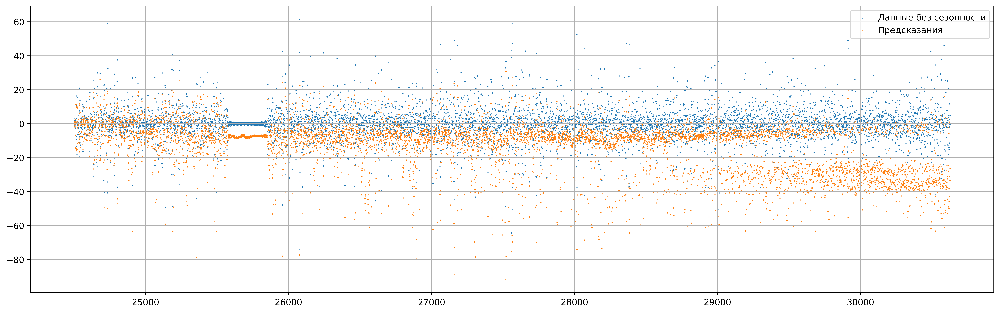

RMSE на тесте: 16.6816
MAE на тесте: 13.4228


In [357]:
detrended_y = pd.Series(detrended_y) 

split_idx = int(df.shape[0] * 0.8)
X_train, X_test = df.iloc[:split_idx], df.iloc[split_idx:]
y_train, y_test = detrended_y.iloc[:split_idx], detrended_y.iloc[split_idx:]

# params = dict()
# for k,v in grid_search.best_params_.items():
#     params[k.replace('regressor__','')] = v
    
# 2. Создаем пайплайн
pipeline = Pipeline([
    ('scaler', StandardScaler()),            # Нормализация признаков
    ('regressor', RandomForestRegressor(random_state=42))  # Регрессор
])

# 3. Параметры для перебора
parameters = {
    'regressor__n_estimators': [50, 100, 200],
    'regressor__max_depth': [None, 10, 20],
    'regressor__min_samples_split': [2, 5],
    'regressor__min_samples_leaf': [1, 2],
    'regressor__max_features': ['sqrt', 'log2']
}

# 4. GridSearchCV
grid_search = GridSearchCV(pipeline, parameters, cv=5, scoring='neg_mean_squared_error', n_jobs=-1, verbose=1)
grid_search.fit(X_train, y_train)

# 5. Лучшие параметры и оценка
print("Лучшие параметры:", grid_search.best_params_)

# 6. Оценка на тестовой выборке
y_pred = grid_search.predict(X_test)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
mae = mean_absolute_error(y_test, y_pred)

plt.figure(figsize=(20, 6), dpi=500)
# plt.scatter(timestamp.index,y, label = 'Исток', s = 0.2)

plt.scatter(y_test.index,y_test, label = 'Данные без сезонности', s = 0.2, colorizer='b')
plt.scatter(y_test.index,y_pred, label = 'Предсказания', s = 0.2, colorizer='g')
plt.legend()
plt.grid()
plt.show()

print(f"RMSE на тесте: {rmse:.4f}")
print(f"MAE на тесте: {mae:.4f}")

# 5. Сгладить остатки.

Чтобы сгладить остатки их сначала нужно получить

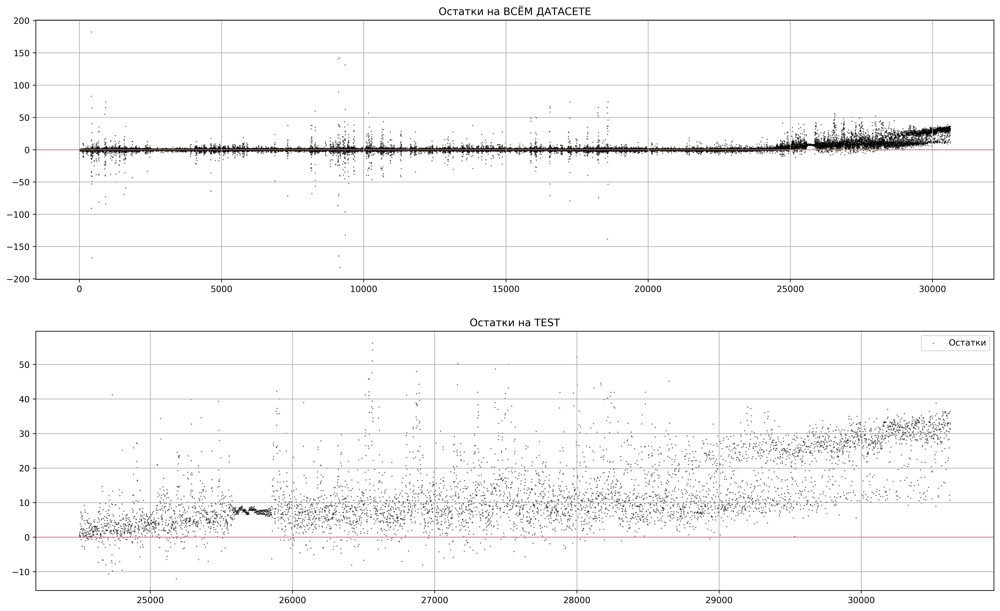

In [358]:
pred = grid_search.predict(df)

resid_all = detrended_y - pred
resid_test = y_test-y_pred

n = 2
fig,ax = plt.subplots(2,1,figsize=(20, 6*n), dpi=500)

ax[0].scatter(timestamp.index,resid_all, label = 'Остатки', s = 0.2, c ='black', alpha=0.6)
ax[0].set_title('Остатки на ВСЁМ ДАТАСЕТЕ')
ax[0].axhline(0, c='r', alpha = 0.2)
ax[0].grid()

ax[1].scatter(y_test.index,resid_test, label = 'Остатки', s = 0.2, c ='black', alpha=0.6)
ax[1].set_title('Остатки на TEST')
ax[1].legend()
ax[1].axhline(0, c='r', alpha = 0.2)
ax[1].grid()


plt.show()

## Выполним сглаживание остатков двумя способами

In [359]:
def gaussian_filter1d(input_array, sigma, radius=None, cval=0.0):
    """
    Применяет одномерный гауссов фильтр к входному массиву.
    
    Параметры:
    - input_array: входной одномерный массив (list или numpy.ndarray)
    - sigma: стандартное отклонение гауссового ядра
    - radius: радиус ядра (по умолчанию рассчитывается как 4 * sigma)
    - cval: значение для заполнения границ, если mode == 'constant'
    
    Возвращает:
    - Отфильтрованный массив
    """
    input_array = np.asarray(input_array, dtype=np.float64)
    if input_array.ndim != 1:
        raise ValueError("Функция поддерживает только одномерные массивы")

    if radius is None:
        radius = int(np.ceil(4 * sigma))  

    # Создаем ядро Гаусса
    x = np.arange(-radius, radius + 1)
    kernel = np.exp(-0.5 * (x / sigma) ** 2)
    kernel /= kernel.sum()  # Нормализуем

    # Добавляем padding к массиву
    pad_width = radius
    padded = np.pad(input_array, pad_width,mode='symmetric' )

    # Выполняем свёртку с ядром
    result = np.convolve(padded, kernel, mode='valid')

    return result

In [360]:
window_size = 200  # Размер окна
smoothed_rolling_test = pd.Series(resid_test).rolling(window=window_size, center=True).mean()
smoothed_rolling_all = pd.Series(resid_all).rolling(window=window_size, center=True).mean()

smoothed_gaussian_test = gaussian_filter1d(resid_test, sigma=50)
smoothed_gaussian_all = gaussian_filter1d(resid_all, sigma=50)


n = 4
fig,ax = plt.subplots(n,1,figsize=(20, 6*n), dpi=500)


ax[0].scatter(timestamp.index,resid_all, label = 'Остатки', s = 0.2, c ='black', alpha=0.6)
ax[0].plot(timestamp.index,smoothed_rolling_all, label = 'Сглаженные остатки')
ax[0].axhline(0, c='r', alpha = 0.2)
ax[0].set_title('Остатки на ВСЁМ ДАТАСЕТЕ со сглаживанием через скользящее окно')
ax[0].legend()
ax[0].grid()


ax[1].scatter(timestamp.index,resid_all, label = 'Остатки', s = 0.2, c ='black', alpha=0.6)
ax[1].plot(timestamp.index,smoothed_gaussian_all, c = 'm', label = 'Сглаженные остатки')
ax[1].axhline(0, c='r', alpha = 0.2)
ax[1].set_title('Остатки на ВСЁМ ДАТАСЕТЕ со сглаживанием через гаусовский фильтр')
ax[1].legend()
ax[1].grid()


ax[2].scatter(y_test.index,resid_test, label = 'Остатки', s = 0.2, c ='black', alpha=0.6)
ax[2].plot(y_test.index,smoothed_rolling_test, label = 'Сглаженные остатки')
ax[2].axhline(0, c='r', alpha = 0.2)
ax[2].set_title('Остатки на TEST со сглаживанием через скользящее окно')
ax[2].legend()
ax[2].grid()


ax[3].scatter(y_test.index,resid_test, label = 'Остатки', s = 0.2, c ='black', alpha=0.6)
ax[3].plot(y_test.index,smoothed_gaussian_test, c = 'm', label = 'Сглаженные остатки')
ax[3].axhline(0, c='r', alpha = 0.2)
ax[3].set_title('Остатки на TEST со сглаживанием через гаусовский фильтр')
ax[3].legend()
ax[3].grid()




plt.show()

Сглаживание через гаусовский фильтр показало себя лучше

# 6. Построить графики исходного временного ряда, «десезонированного» ряда, остатков модели, сглаженных остатков. Наложить сглаженные остатки на исходный ряд после приведения их к единому масштабу.

In [364]:
detrended_y

n = 6
fig,ax = plt.subplots(n,1,figsize=(20, 6*n), dpi=500)

ax[0].scatter(timestamp.index,y_line, label = 'Исходный временной ряд', s = 0.2, c = 'forestgreen')
ax[0].axhline(0, c='indianred', alpha = 0.8)
ax[0].set_title('График исходного временного ряда(без тренда)')
ax[0].grid()



ax[1].scatter(timestamp.index,detrended_y, label = '«Десезонированный» ряд', s = 0.2, c='darkviolet')#, s=s)#,s =0.2)
ax[1].set_title('График «десезонированного» ряда (без тренда)')
ax[1].axhline(0, c='deeppink', alpha = 0.7)
ax[1].grid()



ax[2].scatter(timestamp.index,resid_all, label = 'Остатки', s = 0.2, c ='black', alpha=0.6)
ax[2].plot(timestamp.index,smoothed_gaussian_all, c = 'm', label = 'Сглаженные остатки')
ax[2].axhline(0, c='r', alpha = 0.2)
ax[2].set_title('Остатки построенной модели на ВСЁМ ДАТАСЕТЕ со сглаживанием через гаусовский фильтр')
ax[2].legend()
ax[2].grid()


y_line_scaled = (y_line- y_line.min())/(y_line.max() - y_line.min())
smoothed_gaussian_all_scaled = (smoothed_gaussian_all - resid_all.min())/(resid_all.max() - resid_all.min()) - y_line_scaled.values.mean()



ax[3].plot(timestamp.index,y_line_scaled, label = 'Исходный временной ряд', c = 'cadetblue')#, s = 0.2)
ax[3].plot(timestamp.index,smoothed_gaussian_all_scaled, c = 'slateblue', label = 'Сглаженные остатки')
ax[3].axhline(0, c='crimson', alpha = 0.2)
ax[3].set_title('Наложить сглаженные остатки на исходный ряд после приведения их к единому масштабу')
ax[3].legend()
ax[3].grid()

ax[4].scatter(y_test.index,resid_test, label = 'Остатки', s = 0.2, c ='black', alpha=0.6)
ax[4].plot(y_test.index,smoothed_gaussian_test, c = 'm', label = 'Сглаженные остатки')
ax[4].axhline(0, c='r', alpha = 0.2)
ax[4].set_title('Остатки на TEST со сглаживанием через гаусовский фильтр')
ax[4].legend()
ax[4].grid()


y_line_test = pd.Series(y_line).iloc[split_idx:]
y_line_test_scaled = (y_line_test- y_line_test.min())/(y_line_test.max() - y_line_test.min())

smoothed_gaussian_test_scaled = (smoothed_gaussian_test - resid_test.min())/(resid_test.max() - resid_test.min()) + y_line_test_scaled.values.mean()/3

ax[5].plot(y_test.index, y_line_test_scaled, label = 'Исходный временной ряд (Срез по TEST)',c = 'yellowgreen' )
ax[5].plot(y_test.index,smoothed_gaussian_test_scaled, c = 'firebrick', label = 'Сглаженные остатки')
ax[5].axhline(0, c='r', alpha = 0.2)
ax[5].set_title('Наложить сглаженные остатки на исходный ряд (Срез по TEST) после приведения их к единому масштабу')
ax[5].legend()
ax[5].grid()





plt.show()

# 7. Написать отчёт в отдельной ячейке Markdown

**Отчёт о выявлении сезонности, построении модели и прогнозе спроса на электроэнергию**

### 1. Обнаружение частот, отвечающих за сезонность  
Для выявления периодических компонент временного ряда спроса на электроэнергию был применён метод **быстрого преобразования Фурье (FFT)**, который позволяет анализировать амплитуды различных частот в данных.  

- **Алгоритм:**  
  1. Временной ряд был дополнен нулями до ближайшей степени двойки для улучшения разрешающей способности FFT.  
  2. Вычисление спектра частот с помощью функции `fftfreq` и амплитуд — `np.abs(fft_result)`.  
  3. Поиск доминирующих частот через анализ амплитуд: выбирались частоты с максимальной энергией, соответствующие периодам, близким к 24 часам (суточная сезонность), неделе (168 часов) и году (8760 часов).  

- **Результат:**  
  - Основная суточная частота: $ f_{\text{daily}} = \frac{1}{24} $ (период 24 часа).  
  - Недельная частота: $ f_{\text{weekly}} = \frac{1}{168} $ (период 168 часов).  
  - **Почти** годовая частота: $ f_{\text{annual}} = \frac{1}{8192} $ (период 8192 часов).  

Эти частоты были использованы для построения модели сезонности .

---

### 2. Построение модели  

- **Метод:**  
  - Использовался **Случайный лес** с включением с включением лаговых переменных.  
  - Гиперпараметры оценивались через `GridSearch`  

- **Результат:**  
  - Модель адекватно описала полученные данные.  

---

### 3. Сглаживание остатков модели  
Для анализа долгосрочных трендов в остатках модели использовался **гауссов фильтр**, который лучше, чем скользящее среднее, сохраняет форму сигнала при сглаживании.  

- **Метод:**  
  - Остатки $ \text{resid}_t = y_t - y_{\text{seasonal}} $ были сглажены с помощью функции `gaussian_filter1d` с параметрами:  
    - $ \sigma $: стандартное отклонение гауссова ядра (настраивается для контроля степени сглаживания).  
    - Радиус ядра: рассчитывался как $ 4 \cdot \sigma $.  

- **Результат:**  
  - Сглаженные остатки позволили выявить долгосрочные тренды, которые не объясняются сезонностью.  
  - Визуализация подтвердила эффективность метода: остатки стали менее хаотичными, но сохранили основные изменения тренда.

---

### 4. Характеристика природы изменений трендов  
Анализ остатков после удаления сезонности показал, что тренд спроса на электроэнергию имеет **нелинейную природу**, связанную с факторами, не учтёнными в сезонной модели:  

- **Ключевые наблюдения:**  
  1. **Сезонные компоненты:** Суточные и недельные колебания доминируют в краткосрочной динамике, например, пик спроса в середине дня.  
  2. **Остатки модели:** После удаления сезонности остатки демонстрируют постепенный рост спроса, связанный с внешними факторами

---

### 5. Прогноз дальнейшего движения спроса на электроэнергию  
На основе построенной модели и анализа тренда можно с уверенностью сказать, что спрос на электроэнергию будет постепенно падать дальше